### Indian Cities weather predicition

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

C:\Users\SAIKRISHNA\anaconda3\lib\site-packages\numpy\_distributor_init.py:30: UserWarning: loaded more than 1 DLL from .libs:
C:\Users\SAIKRISHNA\anaconda3\lib\site-packages\numpy\.libs\libopenblas64__v0.3.21-gcc_10_3_0.dll
C:\Users\SAIKRISHNA\anaconda3\lib\site-packages\numpy\.libs\libopenblas64__v0.3.23-246-g3d31191b-gcc_10_3_0.dll
  warnings.warn("loaded more than 1 DLL from .libs:"


In [2]:
train_df = pd.read_csv('IndianWeatherRepository.csv')

In [3]:
train_df

,country,location_name,region,latitude,longitude,timezone,last_updated_epoch,last_updated,temperature_celsius,temperature_fahrenheit,...,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,air_quality_gb-defra-index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination
0,India,Ashoknagar,Madhya Pradesh,24.57,77.72,Asia/Kolkata,1693286100,2023-08-29 10:45,27.5,81.5,...,12.6,18.5,1,2,05:59 AM,06:41 PM,05:42 PM,03:38 AM,Waxing Gibbous,93
1,India,Raisen,Madhya Pradesh,23.33,77.80,Asia/Kolkata,1693286100,2023-08-29 10:45,27.5,81.5,...,10.7,14.2,1,1,06:00 AM,06:40 PM,05:39 PM,03:41 AM,Waxing Gibbous,93
2,India,Chhindwara,Madhya Pradesh,22.07,78.93,Asia/Kolkata,1693286100,2023-08-29 10:45,26.3,79.3,...,16.8,20.7,2,2,05:56 AM,06:34 PM,05:32 PM,03:39 AM,Waxing Gibbous,93
3,India,Betul,Madhya Pradesh,21.86,77.93,Asia/Kolkata,1693286100,2023-08-29 10:45,25.6,78.1,...,4.9,6.6,1,1,06:00 AM,06:38 PM,05:36 PM,03:43 AM,Waxing Gibbous,93
4,India,Hoshangabad,Madhya Pradesh,22.75,77.72,Asia/Kolkata,1693286100,2023-08-29 10:45,27.2,81.0,...,11.4,14.8,1,1,06:01 AM,06:39 PM,05:38 PM,03:42 AM,Waxing Gibbous,93
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64019,India,Niwari,Uttar Pradesh,28.88,77.53,Asia/Kolkata,1703702700,2023-12-28 00:15,12.0,53.6,...,348.0,388.9,6,10,07:12 AM,05:30 PM,05:40 PM,07:33 AM,Full Moon,100
64020,India,Saitual,Mizoram,23.97,92.58,Asia/Kolkata,1703702700,2023-12-28 00:15,10.2,50.4,...,23.5,27.3,2,2,06:01 AM,04:40 PM,04:51 PM,06:16 AM,Full Moon,100
64021,India,Ranipet,Tamil Nadu,12.93,79.33,Asia/Kolkata,1703702700,2023-12-28 00:15,20.9,69.6,...,72.0,85.1,4,10,06:32 AM,05:55 PM,06:14 PM,06:43 AM,Full Moon,100
64022,India,Tenkasi,Tamil Nadu,8.97,77.30,Asia/Kolkata,1703702700,2023-12-28 00:15,20.3,68.6,...,27.6,32.4,2,3,06:33 AM,06:10 PM,06:31 PM,06:42 AM,Full Moon,100


In [4]:
train_df.head()

,country,location_name,region,latitude,longitude,timezone,last_updated_epoch,last_updated,temperature_celsius,temperature_fahrenheit,...,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,air_quality_gb-defra-index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination
0,India,Ashoknagar,Madhya Pradesh,24.57,77.72,Asia/Kolkata,1693286100,2023-08-29 10:45,27.5,81.5,...,12.6,18.5,1,2,05:59 AM,06:41 PM,05:42 PM,03:38 AM,Waxing Gibbous,93
1,India,Raisen,Madhya Pradesh,23.33,77.80,Asia/Kolkata,1693286100,2023-08-29 10:45,27.5,81.5,...,10.7,14.2,1,1,06:00 AM,06:40 PM,05:39 PM,03:41 AM,Waxing Gibbous,93
2,India,Chhindwara,Madhya Pradesh,22.07,78.93,Asia/Kolkata,1693286100,2023-08-29 10:45,26.3,79.3,...,16.8,20.7,2,2,05:56 AM,06:34 PM,05:32 PM,03:39 AM,Waxing Gibbous,93
3,India,Betul,Madhya Pradesh,21.86,77.93,Asia/Kolkata,1693286100,2023-08-29 10:45,25.6,78.1,...,4.9,6.6,1,1,06:00 AM,06:38 PM,05:36 PM,03:43 AM,Waxing Gibbous,93
4,India,Hoshangabad,Madhya Pradesh,22.75,77.72,Asia/Kolkata,1693286100,2023-08-29 10:45,27.2,81.0,...,11.4,14.8,1,1,06:01 AM,06:39 PM,05:38 PM,03:42 AM,Waxing Gibbous,93


In [5]:
train_df.columns

Index(['country', 'location_name', 'region', 'latitude', 'longitude',
       'timezone', 'last_updated_epoch', 'last_updated', 'temperature_celsius',
       'temperature_fahrenheit', 'condition_text', 'wind_mph', 'wind_kph',
       'wind_degree', 'wind_direction', 'pressure_mb', 'pressure_in',
       'precip_mm', 'precip_in', 'humidity', 'cloud', 'feels_like_celsius',
       'feels_like_fahrenheit', 'visibility_km', 'visibility_miles',
       'uv_index', 'gust_mph', 'gust_kph', 'air_quality_Carbon_Monoxide',
       'air_quality_Ozone', 'air_quality_Nitrogen_dioxide',
       'air_quality_Sulphur_dioxide', 'air_quality_PM2.5', 'air_quality_PM10',
       'air_quality_us-epa-index', 'air_quality_gb-defra-index', 'sunrise',
       'sunset', 'moonrise', 'moonset', 'moon_phase', 'moon_illumination'],
      dtype='object')

In [6]:
train_df.drop('country',axis=1,inplace=True)

In [7]:
train_df.drop('timezone',axis=1,inplace=True)

In [8]:
train_df.drop('last_updated_epoch',axis=1,inplace=True)
train_df.drop('last_updated',axis=1,inplace=True)
train_df.drop('temperature_fahrenheit',axis=1,inplace=True)
train_df.drop('wind_mph',axis=1,inplace=True)
train_df.drop('wind_direction',axis=1,inplace=True)
train_df.drop('pressure_in',axis=1,inplace=True)
train_df.drop('precip_in',axis=1,inplace=True)
train_df.drop('feels_like_fahrenheit',axis=1,inplace=True)
train_df.drop('visibility_miles',axis=1,inplace=True)

In [9]:
train_df.head()

,location_name,region,latitude,longitude,temperature_celsius,condition_text,wind_kph,wind_degree,pressure_mb,precip_mm,...,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,air_quality_gb-defra-index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination
0,Ashoknagar,Madhya Pradesh,24.57,77.72,27.5,Partly cloudy,20.5,281,1008.0,0.0,...,12.6,18.5,1,2,05:59 AM,06:41 PM,05:42 PM,03:38 AM,Waxing Gibbous,93
1,Raisen,Madhya Pradesh,23.33,77.80,27.5,Sunny,15.5,287,1008.0,0.0,...,10.7,14.2,1,1,06:00 AM,06:40 PM,05:39 PM,03:41 AM,Waxing Gibbous,93
2,Chhindwara,Madhya Pradesh,22.07,78.93,26.3,Partly cloudy,18.4,317,1009.0,0.0,...,16.8,20.7,2,2,05:56 AM,06:34 PM,05:32 PM,03:39 AM,Waxing Gibbous,93
3,Betul,Madhya Pradesh,21.86,77.93,25.6,Cloudy,16.9,297,1009.0,0.0,...,4.9,6.6,1,1,06:00 AM,06:38 PM,05:36 PM,03:43 AM,Waxing Gibbous,93
4,Hoshangabad,Madhya Pradesh,22.75,77.72,27.2,Cloudy,16.2,274,1009.0,0.0,...,11.4,14.8,1,1,06:01 AM,06:39 PM,05:38 PM,03:42 AM,Waxing Gibbous,93


In [10]:
train_df.columns

Index(['location_name', 'region', 'latitude', 'longitude',
       'temperature_celsius', 'condition_text', 'wind_kph', 'wind_degree',
       'pressure_mb', 'precip_mm', 'humidity', 'cloud', 'feels_like_celsius',
       'visibility_km', 'uv_index', 'gust_mph', 'gust_kph',
       'air_quality_Carbon_Monoxide', 'air_quality_Ozone',
       'air_quality_Nitrogen_dioxide', 'air_quality_Sulphur_dioxide',
       'air_quality_PM2.5', 'air_quality_PM10', 'air_quality_us-epa-index',
       'air_quality_gb-defra-index', 'sunrise', 'sunset', 'moonrise',
       'moonset', 'moon_phase', 'moon_illumination'],
      dtype='object')

In [11]:
train_df.drop('gust_mph',axis=1,inplace=True)
train_df.drop('sunrise',axis=1,inplace=True)
train_df.drop('sunset',axis=1,inplace=True)
train_df.drop('moonrise',axis=1,inplace=True)
train_df.drop('moonset',axis=1,inplace=True)
train_df.drop('moon_phase',axis=1,inplace=True)
train_df.drop('moon_illumination',axis=1,inplace=True)

In [12]:
train_df.head()

,location_name,region,latitude,longitude,temperature_celsius,condition_text,wind_kph,wind_degree,pressure_mb,precip_mm,...,uv_index,gust_kph,air_quality_Carbon_Monoxide,air_quality_Ozone,air_quality_Nitrogen_dioxide,air_quality_Sulphur_dioxide,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,air_quality_gb-defra-index
0,Ashoknagar,Madhya Pradesh,24.57,77.72,27.5,Partly cloudy,20.5,281,1008.0,0.0,...,7.0,23.8,243.7,45.8,1.7,3.1,12.6,18.5,1,2
1,Raisen,Madhya Pradesh,23.33,77.80,27.5,Sunny,15.5,287,1008.0,0.0,...,7.0,18.0,240.3,38.3,2.1,2.6,10.7,14.2,1,1
2,Chhindwara,Madhya Pradesh,22.07,78.93,26.3,Partly cloudy,18.4,317,1009.0,0.0,...,7.0,21.2,220.3,57.2,0.6,1.7,16.8,20.7,2,2
3,Betul,Madhya Pradesh,21.86,77.93,25.6,Cloudy,16.9,297,1009.0,0.0,...,6.0,20.9,200.3,25.0,1.2,1.1,4.9,6.6,1,1
4,Hoshangabad,Madhya Pradesh,22.75,77.72,27.2,Cloudy,16.2,274,1009.0,0.0,...,6.0,18.7,257.0,30.8,2.2,1.8,11.4,14.8,1,1


In [13]:
train_df.columns

Index(['location_name', 'region', 'latitude', 'longitude',
       'temperature_celsius', 'condition_text', 'wind_kph', 'wind_degree',
       'pressure_mb', 'precip_mm', 'humidity', 'cloud', 'feels_like_celsius',
       'visibility_km', 'uv_index', 'gust_kph', 'air_quality_Carbon_Monoxide',
       'air_quality_Ozone', 'air_quality_Nitrogen_dioxide',
       'air_quality_Sulphur_dioxide', 'air_quality_PM2.5', 'air_quality_PM10',
       'air_quality_us-epa-index', 'air_quality_gb-defra-index'],
      dtype='object')

In [14]:
train_df.drop('air_quality_gb-defra-index',axis=1,inplace=True)

In [15]:
train_df.head()

,location_name,region,latitude,longitude,temperature_celsius,condition_text,wind_kph,wind_degree,pressure_mb,precip_mm,...,visibility_km,uv_index,gust_kph,air_quality_Carbon_Monoxide,air_quality_Ozone,air_quality_Nitrogen_dioxide,air_quality_Sulphur_dioxide,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index
0,Ashoknagar,Madhya Pradesh,24.57,77.72,27.5,Partly cloudy,20.5,281,1008.0,0.0,...,10.0,7.0,23.8,243.7,45.8,1.7,3.1,12.6,18.5,1
1,Raisen,Madhya Pradesh,23.33,77.80,27.5,Sunny,15.5,287,1008.0,0.0,...,10.0,7.0,18.0,240.3,38.3,2.1,2.6,10.7,14.2,1
2,Chhindwara,Madhya Pradesh,22.07,78.93,26.3,Partly cloudy,18.4,317,1009.0,0.0,...,10.0,7.0,21.2,220.3,57.2,0.6,1.7,16.8,20.7,2
3,Betul,Madhya Pradesh,21.86,77.93,25.6,Cloudy,16.9,297,1009.0,0.0,...,10.0,6.0,20.9,200.3,25.0,1.2,1.1,4.9,6.6,1
4,Hoshangabad,Madhya Pradesh,22.75,77.72,27.2,Cloudy,16.2,274,1009.0,0.0,...,10.0,6.0,18.7,257.0,30.8,2.2,1.8,11.4,14.8,1


### Correlation

In [16]:
train_df.corr()

,latitude,longitude,temperature_celsius,wind_kph,wind_degree,pressure_mb,precip_mm,humidity,cloud,feels_like_celsius,visibility_km,uv_index,gust_kph,air_quality_Carbon_Monoxide,air_quality_Ozone,air_quality_Nitrogen_dioxide,air_quality_Sulphur_dioxide,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index
latitude,1.000000,0.076211,-0.395927,-0.185325,-0.085465,0.153516,-0.097273,-0.399141,-0.299310,-0.404654,0.151812,0.014687,-0.119187,0.280140,-0.015296,0.234987,0.016991,0.275482,0.292869,0.298637
longitude,0.076211,1.000000,-0.084609,-0.269341,0.003008,-0.028814,0.054924,0.364532,0.175557,-0.060827,-0.156132,0.092463,-0.291584,0.061511,-0.318540,0.009913,0.028163,0.029384,0.014049,-0.012735
temperature_celsius,-0.395927,-0.084609,1.000000,0.224435,0.144451,-0.764883,0.088545,0.285750,0.251985,0.988184,-0.079759,0.223892,0.149249,-0.042015,-0.140028,-0.090939,0.057313,-0.141393,-0.120337,-0.121863
wind_kph,-0.185325,-0.269341,0.224435,1.000000,0.111965,-0.240063,0.091347,0.019264,0.160815,0.222770,0.148622,0.077884,0.876750,-0.225185,0.224020,-0.205228,-0.030261,-0.240901,-0.239318,-0.298339
wind_degree,-0.085465,0.003008,0.144451,0.111965,1.000000,-0.180210,0.015849,-0.006769,0.010853,0.141810,0.101082,0.100484,0.060152,-0.033627,-0.035805,-0.070277,-0.040390,0.012298,0.015296,-0.033670
pressure_mb,0.153516,-0.028814,-0.764883,-0.240063,-0.180210,1.000000,-0.163903,-0.441751,-0.399468,-0.786967,0.043129,-0.158578,-0.137293,0.139744,0.226279,0.192812,-0.008048,0.277564,0.266061,0.305126
precip_mm,-0.097273,0.054924,0.088545,0.091347,0.015849,-0.163903,1.000000,0.186318,0.273730,0.107422,-0.092018,0.038185,0.076740,-0.066173,-0.061819,-0.062981,-0.002417,-0.113128,-0.119480,-0.152796
humidity,-0.399141,0.364532,0.285750,0.019264,-0.006769,-0.441751,0.186318,1.000000,0.588018,0.339587,-0.444444,-0.004124,-0.069590,-0.194857,-0.293422,-0.215927,-0.013386,-0.346402,-0.361107,-0.439158
cloud,-0.299310,0.175557,0.251985,0.160815,0.010853,-0.399468,0.273730,0.588018,1.000000,0.300749,-0.323034,0.039008,0.031186,-0.209008,-0.170470,-0.194883,-0.014543,-0.343823,-0.364200,-0.458596
feels_like_celsius,-0.404654,-0.060827,0.988184,0.222770,0.141810,-0.786967,0.107422,0.339587,0.300749,1.000000,-0.104963,0.230497,0.139542,-0.053547,-0.151643,-0.099246,0.061714,-0.164203,-0.147228,-0.155395


<AxesSubplot:>

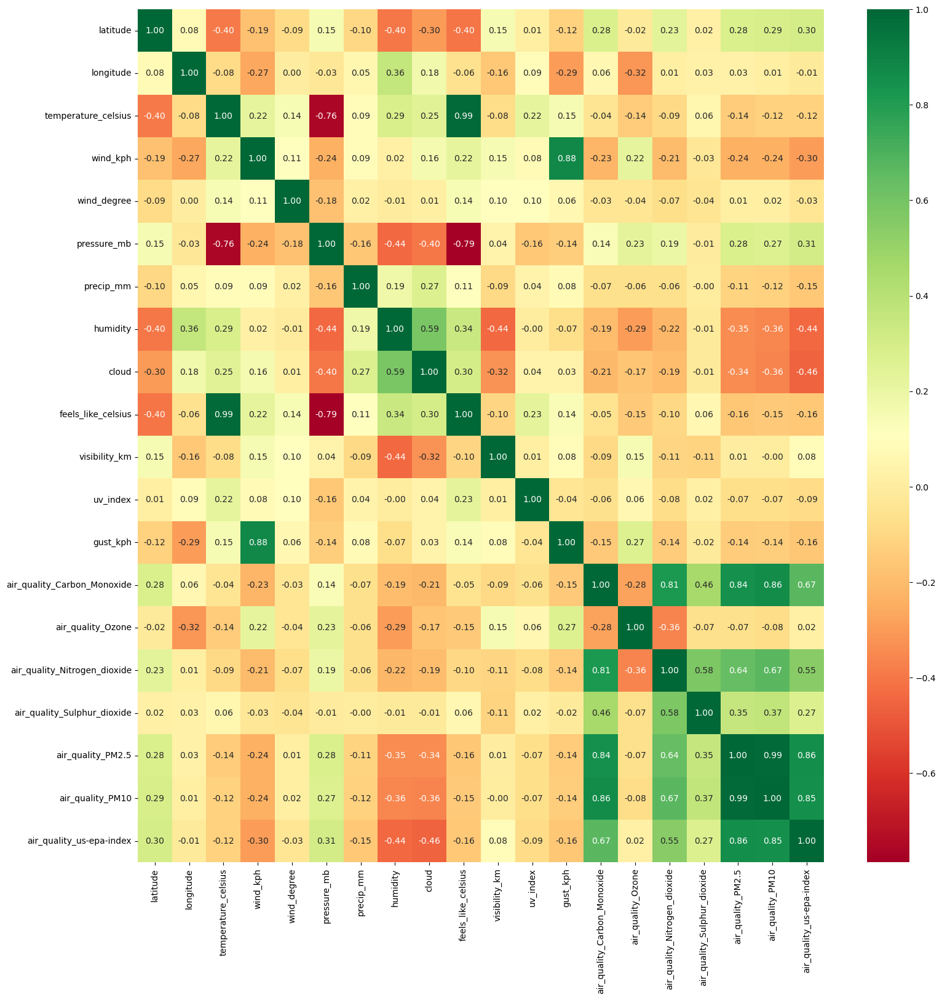

In [17]:
plt.figure(figsize = (18,18))
sns.heatmap(train_df.corr(),annot=True, fmt=".2f",cmap='RdYlGn',)

In [18]:
train_df.describe()

,latitude,longitude,temperature_celsius,wind_kph,wind_degree,pressure_mb,precip_mm,humidity,cloud,feels_like_celsius,visibility_km,uv_index,gust_kph,air_quality_Carbon_Monoxide,air_quality_Ozone,air_quality_Nitrogen_dioxide,air_quality_Sulphur_dioxide,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index
count,64024.000000,64024.000000,64024.000000,64024.000000,64024.000000,64024.000000,64024.000000,64024.000000,64024.000000,64024.000000,64024.000000,64024.000000,64024.000000,64024.000000,64024.000000,64024.000000,64024.000000,64024.000000,64024.000000,64024.000000
mean,23.095422,80.239474,20.999250,7.611521,154.866628,1011.214763,0.140138,69.883278,29.816866,22.118524,8.594457,1.158034,14.253391,767.678503,32.297779,13.568927,5.298671,87.255731,103.062650,3.173779
std,5.795587,5.755244,5.458687,4.354589,113.203858,5.051306,0.808090,20.518239,32.547589,6.674330,2.884193,0.955461,7.404227,634.795115,25.638386,13.929973,11.046687,88.148597,101.216047,1.460498
min,8.080000,68.970000,-18.200000,3.600000,1.000000,991.000000,0.000000,10.000000,0.000000,-24.000000,0.000000,1.000000,0.000000,113.500000,0.000000,0.000000,0.000000,0.500000,0.600000,1.000000
25%,20.270000,76.070000,18.200000,4.000000,55.000000,1007.000000,0.000000,53.000000,3.000000,18.200000,10.000000,1.000000,9.100000,407.200000,12.300000,4.800000,1.300000,24.100000,30.500000,2.000000
50%,23.950000,78.690000,22.000000,6.500000,119.000000,1012.000000,0.000000,73.000000,14.000000,22.000000,10.000000,1.000000,13.200000,587.500000,26.800000,9.500000,2.700000,62.200000,76.200000,3.000000
75%,26.770000,83.900000,24.800000,9.400000,264.250000,1015.000000,0.000000,88.000000,51.000000,26.700000,10.000000,1.000000,18.300000,934.600000,47.200000,17.800000,5.500000,119.800000,140.200000,4.000000
max,34.570000,95.800000,38.300000,43.200000,360.000000,1042.000000,43.800000,100.000000,100.000000,50.500000,10.000000,9.000000,82.200000,13565.100000,234.600000,274.200000,541.700000,1374.800000,1537.800000,6.000000


#### Checking Data Types

In [19]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 64024 entries, 0 to 64023
Data columns (total 23 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   location_name                 64024 non-null  object 
 1   region                        64024 non-null  object 
 2   latitude                      64024 non-null  float64
 3   longitude                     64024 non-null  float64
 4   temperature_celsius           64024 non-null  float64
 5   condition_text                64024 non-null  object 
 6   wind_kph                      64024 non-null  float64
 7   wind_degree                   64024 non-null  int64  
 8   pressure_mb                   64024 non-null  float64
 9   precip_mm                     64024 non-null  float64
 10  humidity                      64024 non-null  int64  
 11  cloud                         64024 non-null  int64  
 12  feels_like_celsius            64024 non-null  float64
 13  v

### Checking for null values

In [20]:
train_df.isnull().sum()

location_name                   0
region                          0
latitude                        0
longitude                       0
temperature_celsius             0
condition_text                  0
wind_kph                        0
wind_degree                     0
pressure_mb                     0
precip_mm                       0
humidity                        0
cloud                           0
feels_like_celsius              0
visibility_km                   0
uv_index                        0
gust_kph                        0
air_quality_Carbon_Monoxide     0
air_quality_Ozone               0
air_quality_Nitrogen_dioxide    0
air_quality_Sulphur_dioxide     0
air_quality_PM2.5               0
air_quality_PM10                0
air_quality_us-epa-index        0
dtype: int64

### EDA

In [21]:
train_df['location_name'].unique()

array(['Ashoknagar', 'Raisen', 'Chhindwara', 'Betul', 'Hoshangabad',
       'Sehore', 'Jabalpur', 'Narsimhapur', 'Panna', 'Ujjain', 'Rewa',
       'Dindori', 'Balaghat', 'Barwani', 'Satna', 'Chhatarpur', 'Indore',
       'Ratlam', 'Harda', 'Sagar', 'Neemuch', 'Tikamgarh', 'Guna',
       'Dewas', 'Mandsaur', 'Khargone', 'Sheopur', 'Morena', 'Bhind',
       'Jhabua', 'Seoni', 'Khandwa', 'Umaria', 'Gwalior', 'Damoh', 'Dhar',
       'Katni', 'Sidhi', 'Alirajpur', 'Bhopal', 'Rajgarh', 'Mandla',
       'Shajapur', 'Shivpuri', 'Datia', 'Burhanpur', 'Anuppur', 'Shahdol',
       'Vidisha', 'Una', 'Solan', 'Sirmaur', 'Chamba', 'Shimla',
       'Bilaspur', 'Kangra', 'Mandi', 'Hamirpur', 'Talab Data',
       'Anantnag', 'Baramula', 'Kulgam', 'Shupiyan', 'Jammu', 'Leh',
       'Srinagar', 'Doda', 'Pulwama', 'Ramban', 'Ganderbal', 'Udhampur',
       'Badgam', 'Punch', 'Kupwara', 'Samba', 'Kathua', 'Kargil',
       'Kishtwar', 'Daman', 'Diu', 'Bhavnagar', 'Udaipur', 'Vadodara',
       'Kantha', 'Sure

In [22]:
train_df['location_name'].value_counts()

Udaipur          230
East Godavari    200
Siang            192
Kolkata          169
Barddhaman       169
                ... 
Narsimhapur      116
Seoni            116
Palghar          116
Mancherial       116
Badgam           116
Name: location_name, Length: 543, dtype: int64

In [23]:
train_df['region'].unique()

array(['Madhya Pradesh', 'Uttar Pradesh', 'Orissa', 'Rajasthan',
       'Gujarat', 'Himachal Pradesh', 'Chhattisgarh', 'Jammu and Kashmir',
       'Daman and Diu', 'Dadra and Nagar Haveli', 'Andhra Pradesh',
       'Jharkhand', 'Bihar', 'West Bengal', 'Maharashtra', 'Haryana',
       'Chandigarh', 'Goa', 'Andaman and Nicobar Islands',
       'Arunachal Pradesh', 'Assam', 'Puducherry', 'Kerala', 'Mizoram',
       'Manipur', 'Nagaland', 'Tripura', 'Karnataka', 'Uttarakhand',
       'Lakshadweep', 'Punjab', 'Tamil Nadu', 'Delhi'], dtype=object)

In [24]:
train_df['region'].value_counts()

Uttar Pradesh                  7142
Madhya Pradesh                 5614
Rajasthan                      4225
Andhra Pradesh                 3826
Maharashtra                    3761
Bihar                          3393
Tamil Nadu                     3276
Orissa                         2918
Karnataka                      2705
Chhattisgarh                   2694
Gujarat                        2691
Assam                          2467
West Bengal                    2447
Haryana                        2340
Jammu and Kashmir              2338
Punjab                         2223
Jharkhand                      2106
Kerala                         1638
Uttarakhand                    1287
Manipur                         937
Mizoram                         819
Nagaland                        701
Himachal Pradesh                585
Tripura                         249
Goa                             238
Delhi                           234
Puducherry                      234
Arunachal Pradesh           

In [25]:
train_df['weather']=train_df['condition_text']

In [26]:
train_df.columns

Index(['location_name', 'region', 'latitude', 'longitude',
       'temperature_celsius', 'condition_text', 'wind_kph', 'wind_degree',
       'pressure_mb', 'precip_mm', 'humidity', 'cloud', 'feels_like_celsius',
       'visibility_km', 'uv_index', 'gust_kph', 'air_quality_Carbon_Monoxide',
       'air_quality_Ozone', 'air_quality_Nitrogen_dioxide',
       'air_quality_Sulphur_dioxide', 'air_quality_PM2.5', 'air_quality_PM10',
       'air_quality_us-epa-index', 'weather'],
      dtype='object')

In [27]:
train_df.head()

,location_name,region,latitude,longitude,temperature_celsius,condition_text,wind_kph,wind_degree,pressure_mb,precip_mm,...,uv_index,gust_kph,air_quality_Carbon_Monoxide,air_quality_Ozone,air_quality_Nitrogen_dioxide,air_quality_Sulphur_dioxide,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,weather
0,Ashoknagar,Madhya Pradesh,24.57,77.72,27.5,Partly cloudy,20.5,281,1008.0,0.0,...,7.0,23.8,243.7,45.8,1.7,3.1,12.6,18.5,1,Partly cloudy
1,Raisen,Madhya Pradesh,23.33,77.80,27.5,Sunny,15.5,287,1008.0,0.0,...,7.0,18.0,240.3,38.3,2.1,2.6,10.7,14.2,1,Sunny
2,Chhindwara,Madhya Pradesh,22.07,78.93,26.3,Partly cloudy,18.4,317,1009.0,0.0,...,7.0,21.2,220.3,57.2,0.6,1.7,16.8,20.7,2,Partly cloudy
3,Betul,Madhya Pradesh,21.86,77.93,25.6,Cloudy,16.9,297,1009.0,0.0,...,6.0,20.9,200.3,25.0,1.2,1.1,4.9,6.6,1,Cloudy
4,Hoshangabad,Madhya Pradesh,22.75,77.72,27.2,Cloudy,16.2,274,1009.0,0.0,...,6.0,18.7,257.0,30.8,2.2,1.8,11.4,14.8,1,Cloudy


In [28]:
train_df.drop('condition_text',axis=1,inplace=True)

In [29]:
train_df.head(2)

,location_name,region,latitude,longitude,temperature_celsius,wind_kph,wind_degree,pressure_mb,precip_mm,humidity,...,uv_index,gust_kph,air_quality_Carbon_Monoxide,air_quality_Ozone,air_quality_Nitrogen_dioxide,air_quality_Sulphur_dioxide,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,weather
0,Ashoknagar,Madhya Pradesh,24.57,77.72,27.5,20.5,281,1008.0,0.0,67,...,7.0,23.8,243.7,45.8,1.7,3.1,12.6,18.5,1,Partly cloudy
1,Raisen,Madhya Pradesh,23.33,77.80,27.5,15.5,287,1008.0,0.0,70,...,7.0,18.0,240.3,38.3,2.1,2.6,10.7,14.2,1,Sunny


In [30]:
train_df['weather'].value_counts()

Clear                                  34173
Mist                                    8957
Partly cloudy                           7176
Patchy rain possible                    4740
Light rain shower                       2628
Fog                                     1247
Overcast                                1185
Cloudy                                  1181
Sunny                                    772
Light rain                               416
Moderate or heavy rain shower            389
Light drizzle                            218
Patchy light drizzle                     184
Moderate rain                            159
Moderate or heavy rain with thunder      134
Patchy light rain                        114
Moderate rain at times                    72
Patchy light rain with thunder            71
Thundery outbreaks possible               59
Heavy rain                                56
Torrential rain shower                    34
Light freezing rain                       21
Patchy lig

### DATA VIZ

In [31]:
import plotly.express as px
# Scatter Plots for Air Quality Metrics vs Temperature
air_quality_metrics = ['air_quality_Carbon_Monoxide', 'air_quality_Ozone', 'air_quality_Nitrogen_dioxide', 'air_quality_Sulphur_dioxide', 'air_quality_PM2.5', 'air_quality_PM10']

for metric in air_quality_metrics:
    fig = px.scatter(train_df, x='temperature_celsius', y=metric, title=f'Temperature vs {metric}')
    fig.show()

In [32]:
##Most polluting state
most_polluting_state = train_df.groupby('region')['air_quality_PM2.5'].mean().idxmax()
fig = px.bar(train_df.groupby('region')['air_quality_PM2.5'].mean().reset_index(), x='region', y='air_quality_PM2.5', title='Average PM2.5 by State')
fig.show()
print(f"The most polluting state is {most_polluting_state}")

The most polluting state is Delhi


In [33]:
##Most polluting state
most_polluting_state_Pm10 = train_df.groupby('region')['air_quality_PM10'].mean().idxmax()
fig = px.bar(train_df.groupby('region')['air_quality_PM10'].mean().reset_index(), x='region', y='air_quality_PM10', title='Average PM10 by State')
fig.show()
print(f"The most polluting state is {most_polluting_state_Pm10 }")

The most polluting state is Delhi


C:\Users\SAIKRISHNA\AppData\Local\Temp\ipykernel_8208\1277842713.py:1: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




<AxesSubplot:xlabel='temperature_celsius', ylabel='Density'>

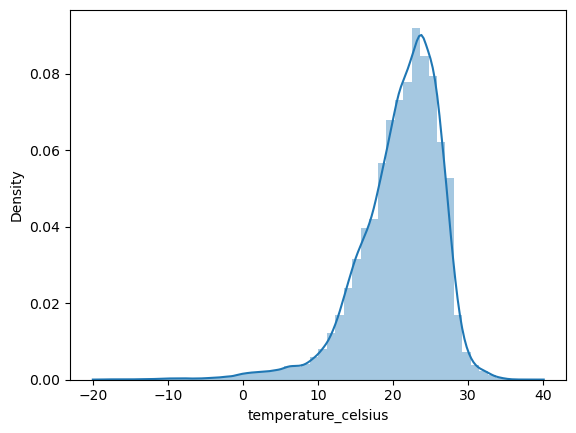

In [34]:
sns.distplot(train_df['temperature_celsius'])

#### Boxplot to check for outliers in temperature

(array([-30., -20., -10.,   0.,  10.,  20.,  30.,  40.,  50.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

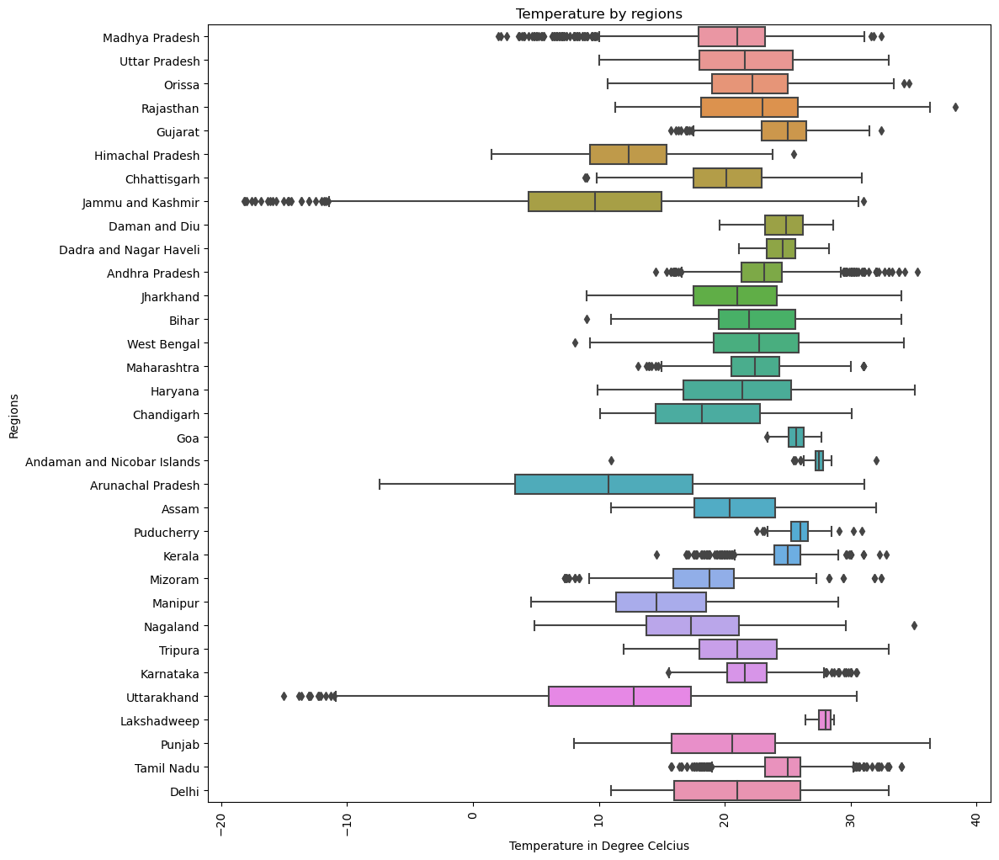

In [35]:
plt.figure(figsize=(12,12))
sns.boxplot(data=train_df,x='temperature_celsius',y='region')
plt.xlabel('Temperature in Degree Celcius')
plt.ylabel('Regions')
plt.title('Temperature by regions')
plt.xticks(rotation=90)

#### Checking for outliers in humidity

(array([  0.,  20.,  40.,  60.,  80., 100., 120.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

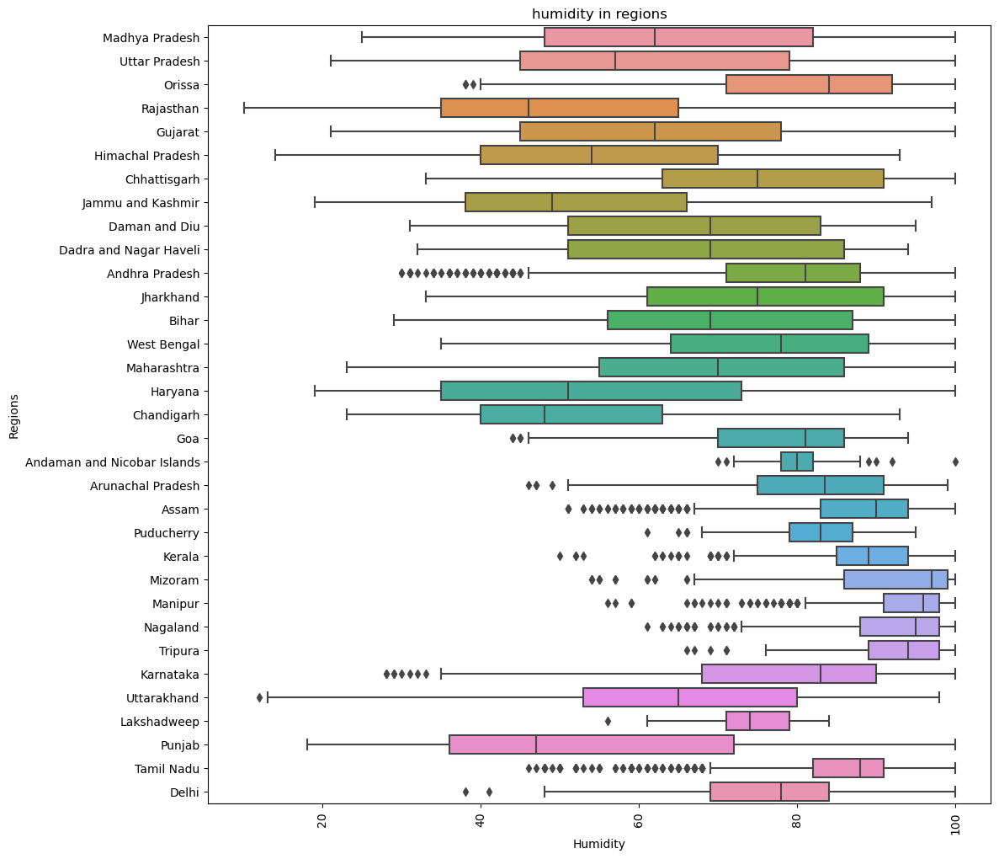

In [36]:
plt.figure(figsize=(12,12))
sns.boxplot(data=train_df,x='humidity',y='region')
plt.xlabel('Humidity')
plt.ylabel('Regions')
plt.title('humidity in regions')
plt.xticks(rotation=90)

#### Cloud Cover in regions

(array([-20.,   0.,  20.,  40.,  60.,  80., 100., 120.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

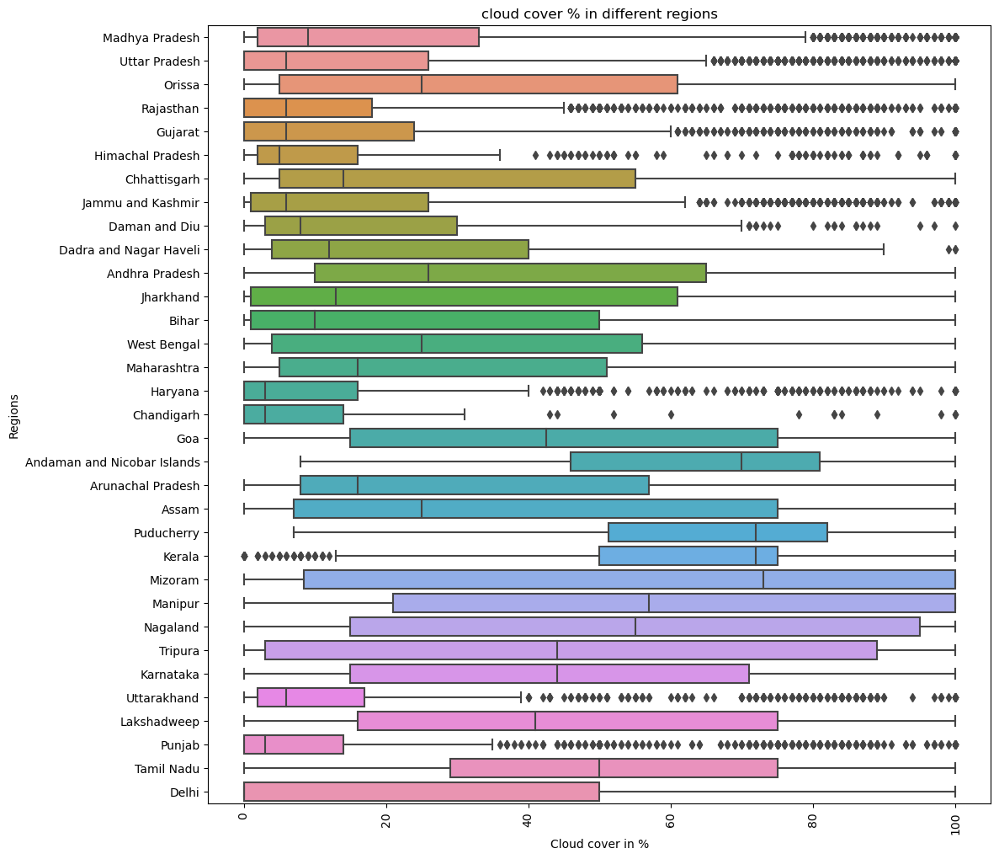

In [37]:
plt.figure(figsize=(12,12))
sns.boxplot(data=train_df,x='cloud',y='region')
plt.xlabel('Cloud cover in %')
plt.ylabel('Regions')
plt.title('cloud cover % in different regions')
plt.xticks(rotation=90)

#### UV index in different regions

(array([0. , 0.2, 0.4, 0.6, 0.8, 1. , 1.2, 1.4, 1.6, 1.8]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

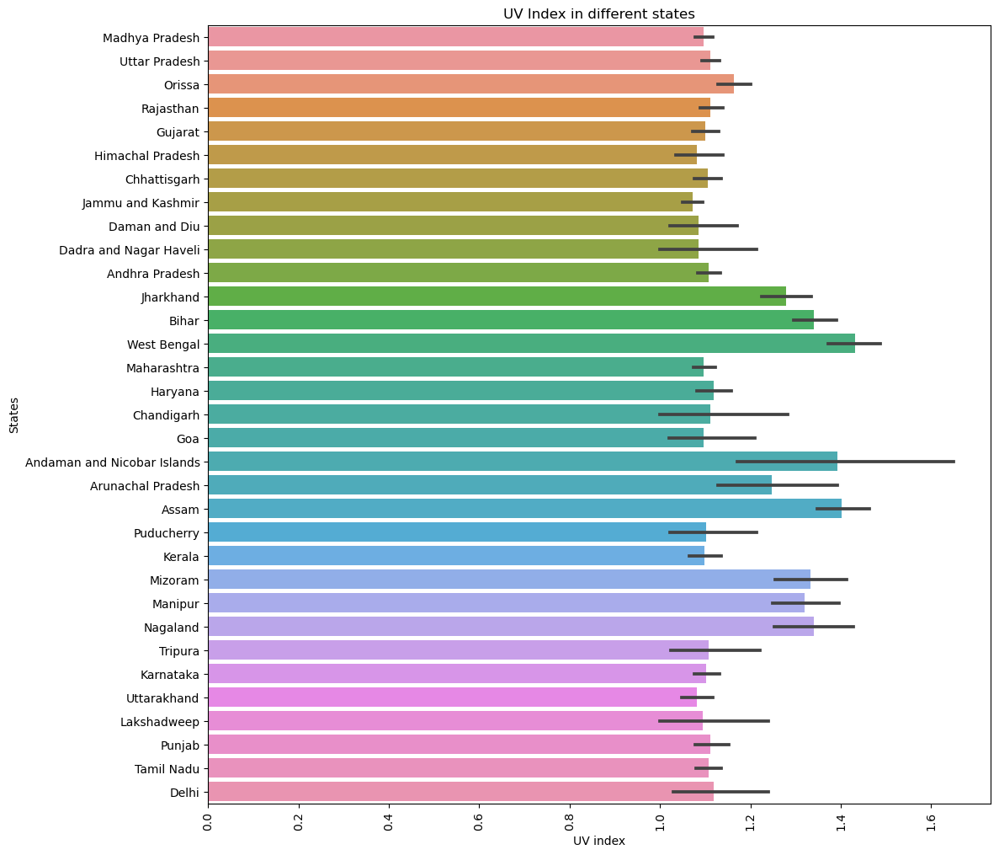

In [38]:
plt.figure(figsize=(12,12))
sns.barplot(x='uv_index',y='region',data=train_df)
plt.xlabel('UV index')
plt.ylabel('States')
plt.title('UV Index in different states')
plt.xticks(rotation=90)

Text(0.5, 1.0, 'UV Index Distribution')

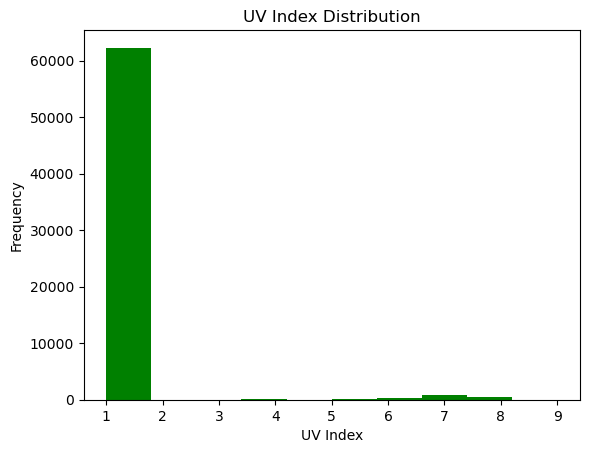

In [39]:
plt.hist(train_df['uv_index'],color='green')
plt.xlabel('UV Index')
plt.ylabel('Frequency')
plt.title('UV Index Distribution')

Text(0.5, 1.0, 'Temperature Distribution')

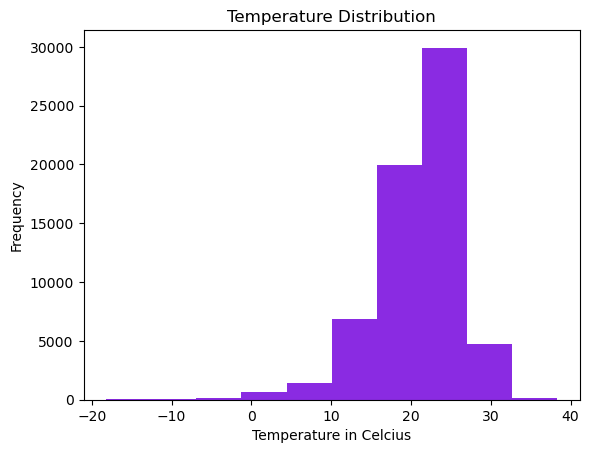

In [40]:
plt.hist(train_df['temperature_celsius'],bins=10,color='blueviolet')
plt.xlabel('Temperature in Celcius')
plt.ylabel('Frequency')
plt.title('Temperature Distribution')

Text(0.5, 1.0, 'Humidity Distribution')

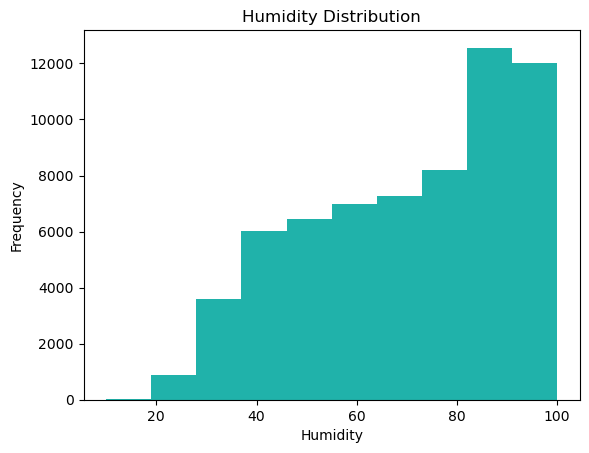

In [41]:
plt.hist(train_df['humidity'],bins=10,color='lightseagreen')
plt.xlabel('Humidity')
plt.ylabel('Frequency')
plt.title('Humidity Distribution')

Text(0.5, 1.0, 'Air Quality-US EPA INDEX Distribution')

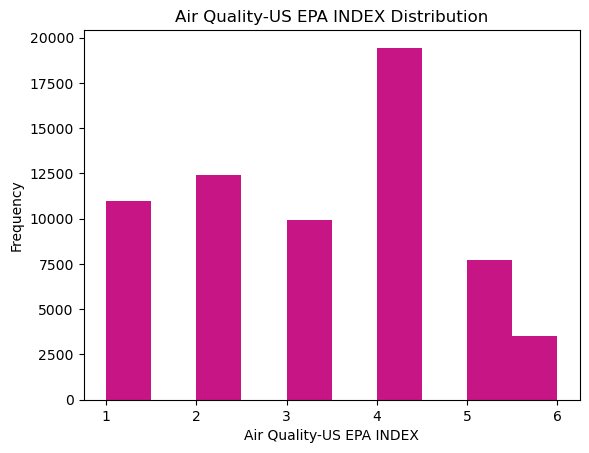

In [42]:
plt.hist(train_df['air_quality_us-epa-index'],color='mediumvioletred')
plt.xlabel('Air Quality-US EPA INDEX')
plt.ylabel('Frequency')
plt.title('Air Quality-US EPA INDEX Distribution')

Text(0.5, 1.0, 'Temperature vs Humidity')

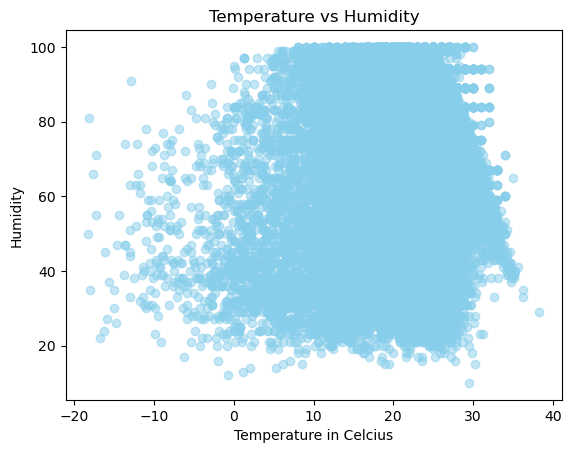

In [43]:
plt.scatter(train_df['temperature_celsius'],train_df['humidity'],color='skyblue',alpha=0.5)
plt.xlabel('Temperature in Celcius')
plt.ylabel('Humidity')
plt.title('Temperature vs Humidity')

(array([ 0.,  5., 10., 15., 20., 25., 30., 35., 40., 45., 50.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

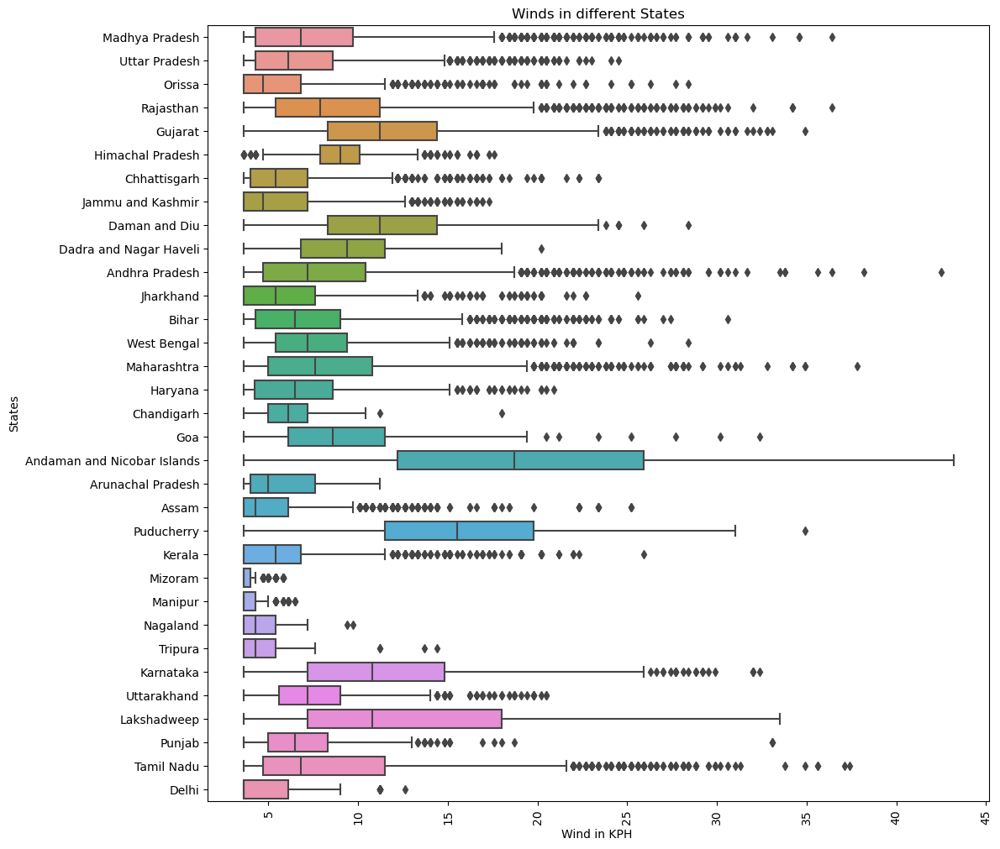

In [44]:
plt.figure(figsize=(12,12))
sns.boxplot(data=train_df,x='wind_kph',y='region')
plt.xlabel('Wind in KPH ')
plt.ylabel('States')
plt.title('Winds in different States')
plt.xticks(rotation=90)

(array([-20.,   0.,  20.,  40.,  60.,  80., 100.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

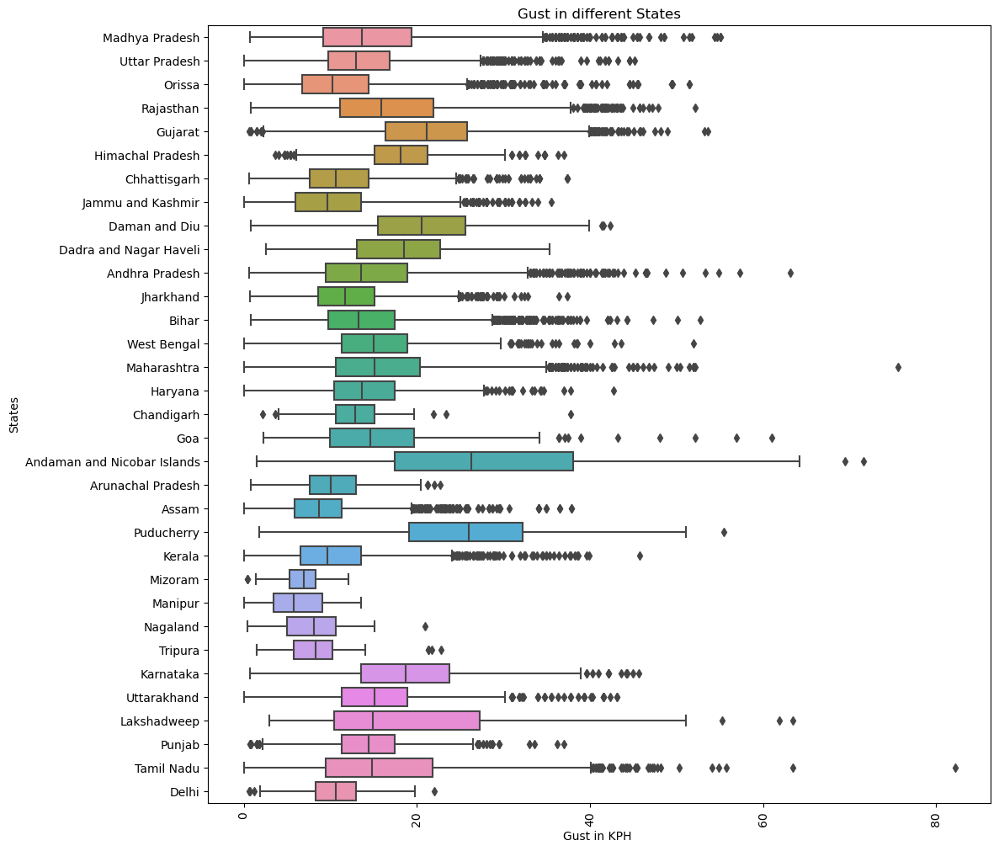

In [45]:
plt.figure(figsize=(12,12))
sns.boxplot(data=train_df,x='gust_kph',y='region')
plt.xlabel('Gust in KPH ')
plt.ylabel('States')
plt.title('Gust in different States')
plt.xticks(rotation=90)

In [46]:
##Most polluting state
Temp_in_states = train_df.groupby('region')['temperature_celsius'].mean().idxmax()
fig = px.bar(train_df.groupby('region')['temperature_celsius'].mean().reset_index(), x='region', y='temperature_celsius', title='Average Temperature by State')
fig.show()
print(f" High average temperature in a state is {Temp_in_states}")

 High average temperature in a state is Lakshadweep


In [47]:
humidity_states=train_df.groupby('region')['humidity'].mean().idxmax()
fig=px.bar(train_df.groupby('region')['humidity'].mean().reset_index(),x='region',y='humidity',title='Average humidity in states')
fig.show()
print(f" The region with high average humidity is {humidity_states}")

 The region with high average humidity is Manipur


#### visualizing top cities/regions

In [48]:
df = train_df.sort_values(by='temperature_celsius', ascending=False)

highest_temp_row = df.iloc[0]
location_name = highest_temp_row['location_name']
region = highest_temp_row['region']
temp_celsius = highest_temp_row['temperature_celsius']

print(f"The city with the highest temperature in celsius is {location_name}, {region}  with a temperature of {temp_celsius}°C. ")

The city with the highest temperature in celsius is Bikaner, Rajasthan  with a temperature of 38.3°C. 


In [49]:
location = df['location_name'].head(5)
temps_celsius = df['temperature_celsius'].head(5)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


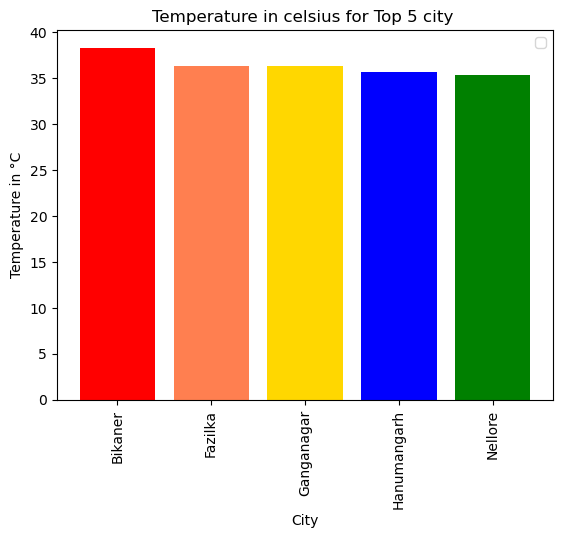

In [50]:
colors=['red','coral','gold','blue','green']
plt.bar(location,temps_celsius,color=colors)
plt.title('Temperature in celsius for Top 5 city ')
plt.xlabel('City')
plt.ylabel('Temperature in °C')
plt.xticks(rotation=90)
plt.legend()

In [51]:
average_pm_2_5 = df['air_quality_PM2.5'].mean()
average_pm_10 = df ['air_quality_PM10'] .mean()

In [52]:
print(f'The average air quality PM2.5 across all location is {average_pm_2_5:.2f}')
print(f'The average air quality PM10 across all location is {average_pm_10:.2f}')

The average air quality PM2.5 across all location is 87.26
The average air quality PM10 across all location is 103.06


In [53]:
df1 = train_df.sort_values(by='air_quality_PM2.5', ascending=False)
high_pm_2_5 = df1['air_quality_PM2.5'].head(5)
location_highpm_2_5 = df1 ['location_name'].head(5)

([0, 1, 2, 3],
 [Text(0, 0, ''), Text(0, 0, ''), Text(0, 0, ''), Text(0, 0, '')])

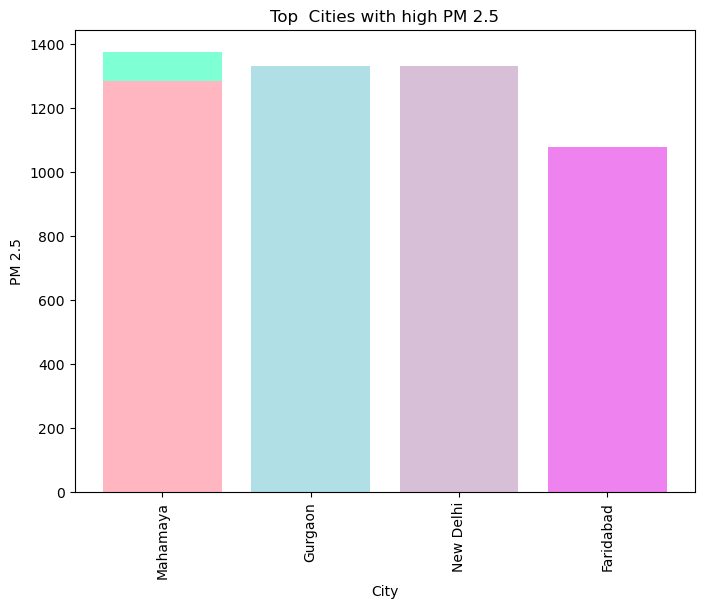

In [54]:
color_pm2_5 =['aquamarine','powderblue','thistle','lightpink','violet']
plt.figure(figsize=(8,6))
plt.bar(location_highpm_2_5,high_pm_2_5,color=color_pm2_5)
plt.title('Top  Cities with high PM 2.5')
plt.xlabel('City')
plt.ylabel('PM 2.5')
plt.xticks(rotation=90)

In [55]:
df2=train_df.sort_values(by='air_quality_PM10', ascending=False)
high_pm_10 = df2['air_quality_PM10'].head(5)
location_highpm_10 = df2 ['location_name'].head(5)

In [56]:
df2

,location_name,region,latitude,longitude,temperature_celsius,wind_kph,wind_degree,pressure_mb,precip_mm,humidity,...,uv_index,gust_kph,air_quality_Carbon_Monoxide,air_quality_Ozone,air_quality_Nitrogen_dioxide,air_quality_Sulphur_dioxide,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,weather
48131,New Delhi,Delhi,28.60,77.20,16.0,9.0,70,1016.0,0.02,94,...,1.0,7.6,12176.5,0.0,160.4,51.0,1329.2,1537.8,6,Mist
47764,Gurgaon,Haryana,28.47,77.03,16.0,9.0,70,1016.0,0.00,94,...,1.0,8.2,12176.5,0.0,160.4,51.0,1329.2,1537.8,6,Mist
28898,Mahamaya,West Bengal,22.07,88.44,23.3,10.1,16,1012.0,0.00,75,...,1.0,21.2,13565.1,0.0,113.8,83.0,1374.8,1498.0,6,Clear
28349,Mahamaya,West Bengal,22.07,88.44,26.0,9.0,10,1012.0,0.00,84,...,1.0,17.0,11749.3,0.0,67.2,68.7,1282.6,1422.5,6,Mist
42307,Faridabad,Haryana,28.43,77.32,17.0,3.6,10,1016.0,0.00,88,...,1.0,10.6,12390.1,0.0,274.2,259.4,1078.3,1326.3,6,Mist
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8196,Tenkasi,Tamil Nadu,8.97,77.30,22.8,13.7,270,1010.0,0.00,92,...,1.0,17.6,193.6,32.9,1.0,0.2,0.5,0.7,1,Cloudy
34751,Kavaratti,Lakshadweep,10.57,72.62,27.2,7.9,167,1011.0,1.66,78,...,1.0,12.1,350.5,62.2,0.2,0.0,0.5,0.7,1,Light rain shower
18388,Hassan,Karnataka,13.00,76.10,19.6,18.4,238,1010.0,0.07,94,...,1.0,26.6,205.3,20.2,1.2,0.2,0.5,0.7,1,Patchy rain possible
7931,Idukki,Kerala,9.85,76.97,21.8,12.6,249,1010.0,0.00,91,...,1.0,14.4,175.2,29.7,0.4,0.1,0.5,0.7,1,Partly cloudy


([0, 1, 2, 3],
 [Text(0, 0, ''), Text(0, 0, ''), Text(0, 0, ''), Text(0, 0, '')])

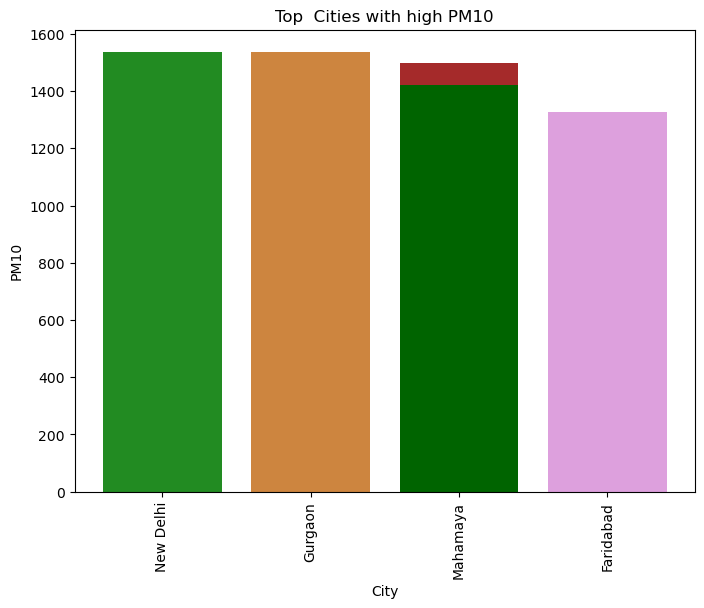

In [57]:
color_PM10=['forestgreen','peru','brown','darkgreen','plum']
plt.figure(figsize=(8,6))
plt.bar(location_highpm_10,high_pm_10,color=color_PM10)
plt.title('Top  Cities with high PM10')
plt.xlabel('City')
plt.ylabel('PM10')
plt.xticks(rotation=90)

In [58]:
average_CO_inair = df['air_quality_Carbon_Monoxide'].mean()

In [59]:
average_CO_inair 

767.6785033737386

In [60]:
threshold = average_CO_inair
high_CO_inair = df[df['air_quality_Carbon_Monoxide']> threshold]

if not high_CO_inair.empty:
    print("Location with  carbon monoxide air quality higher than threshold is :")
    print(high_CO_inair[['location_name','air_quality_Carbon_Monoxide']])
else:
    print('No location has Carbon Monoxide higher than threshold value')

Location with  carbon monoxide air quality higher than threshold is :
        location_name  air_quality_Carbon_Monoxide
448          Mahamaya                       2296.5
534    South Suburban                       1161.6
299             Hugli                        881.2
222         Bishnupur                       1161.6
289           Kolkata                       1161.6
...               ...                          ...
58061          Kulgam                       1094.8
58604        Anantnag                       1094.8
58607        Shupiyan                       1094.8
58606          Kulgam                       1094.8
59167         Kupwara                       1121.5

[21818 rows x 2 columns]


Text(0, 0.5, 'Frequency')

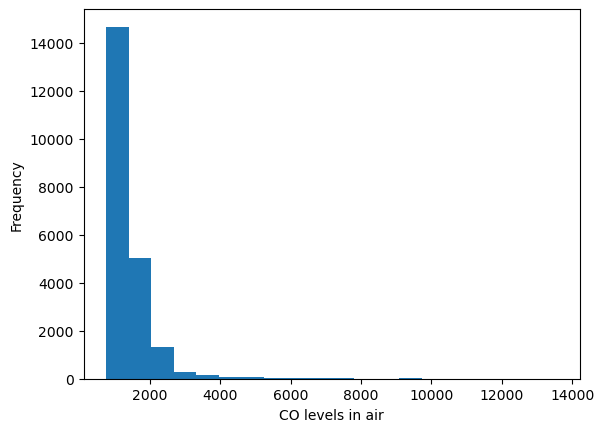

In [61]:
plt.hist(high_CO_inair['air_quality_Carbon_Monoxide'],bins=20)
plt.xlabel('CO levels in air')
plt.ylabel('Frequency')

In [62]:
df3 = train_df.sort_values(by='air_quality_Carbon_Monoxide',ascending=False)
high_CO_air = df3['air_quality_Carbon_Monoxide'].head()
location_high_CO = df3 ['location_name'].head()

In [63]:
df3

,location_name,region,latitude,longitude,temperature_celsius,wind_kph,wind_degree,pressure_mb,precip_mm,humidity,...,uv_index,gust_kph,air_quality_Carbon_Monoxide,air_quality_Ozone,air_quality_Nitrogen_dioxide,air_quality_Sulphur_dioxide,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,weather
28898,Mahamaya,West Bengal,22.07,88.44,23.3,10.1,16,1012.0,0.00,75,...,1.0,21.2,13565.1,0.0,113.8,83.0,1374.8,1498.0,6,Clear
42307,Faridabad,Haryana,28.43,77.32,17.0,3.6,10,1016.0,0.00,88,...,1.0,10.6,12390.1,0.0,274.2,259.4,1078.3,1326.3,6,Mist
48131,New Delhi,Delhi,28.60,77.20,16.0,9.0,70,1016.0,0.02,94,...,1.0,7.6,12176.5,0.0,160.4,51.0,1329.2,1537.8,6,Mist
47764,Gurgaon,Haryana,28.47,77.03,16.0,9.0,70,1016.0,0.00,94,...,1.0,8.2,12176.5,0.0,160.4,51.0,1329.2,1537.8,6,Mist
28349,Mahamaya,West Bengal,22.07,88.44,26.0,9.0,10,1012.0,0.00,84,...,1.0,17.0,11749.3,0.0,67.2,68.7,1282.6,1422.5,6,Mist
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17774,Uttarkashi,Uttarakhand,30.73,78.45,-4.3,5.0,168,1021.0,0.00,73,...,1.0,10.6,125.2,98.7,0.1,0.1,3.2,4.1,1,Clear
5678,Saiha,Mizoram,22.48,92.97,20.9,3.6,128,1007.0,0.50,99,...,1.0,6.5,120.2,0.0,0.5,0.0,1.8,2.1,1,Light rain shower
5677,Lawngtlai,Mizoram,22.53,92.90,20.9,3.6,128,1007.0,0.50,99,...,1.0,6.5,120.2,0.0,0.5,0.0,1.8,2.1,1,Light rain shower
6777,Saiha,Mizoram,22.48,92.97,21.3,3.6,77,1006.0,0.10,99,...,1.0,2.9,113.5,0.4,0.5,0.0,1.2,1.4,1,Fog


Text(0.5, 1.0, ' Cities with highest CO Levels in Air')

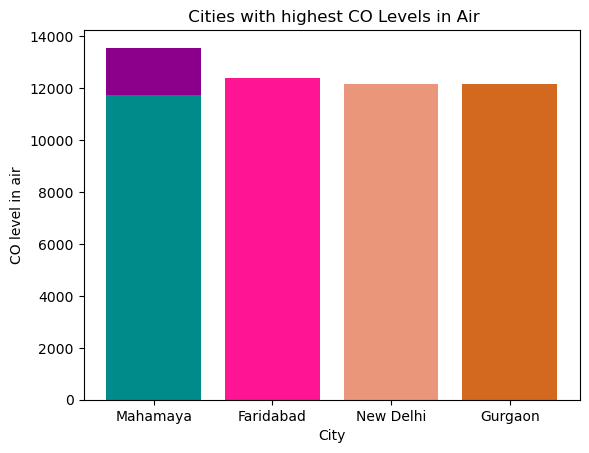

In [64]:
color_CO=['darkmagenta','deeppink','darksalmon','chocolate','darkcyan']
plt.bar(location_high_CO,high_CO_air,color=color_CO)
plt.xlabel('City')
plt.ylabel('CO level in air')
plt.title(' Cities with highest CO Levels in Air')

In [65]:
df3 = train_df.sort_values(by='air_quality_Carbon_Monoxide',ascending=False)
low_CO_air = df3['air_quality_Carbon_Monoxide'].tail()
location_low_CO = df3 ['location_name'].tail()

Text(0.5, 1.0, ' Cities with lowest CO Levels in Air')

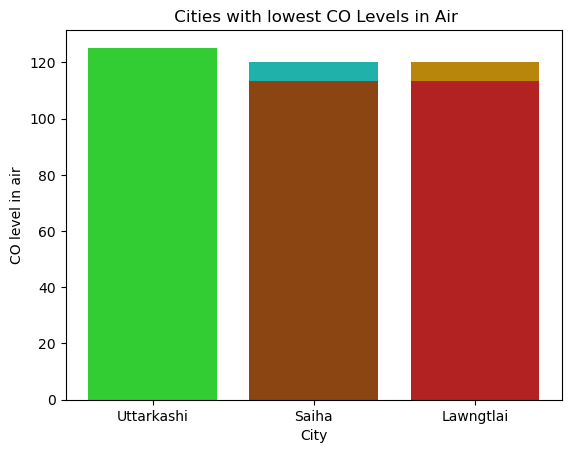

In [66]:
color_CO_low=['limegreen','lightseagreen','darkgoldenrod','saddlebrown','firebrick']
plt.bar(location_low_CO,low_CO_air,color=color_CO_low)
plt.xlabel('City')
plt.ylabel('CO level in air')
plt.title(' Cities with lowest CO Levels in Air')

In [67]:
df4 = train_df.sort_values(by='air_quality_Sulphur_dioxide',ascending=False)
high_SO2_air = df4['air_quality_Sulphur_dioxide'].head()
location_high_SO2 = df4 ['location_name'].head()

In [68]:
df4

,location_name,region,latitude,longitude,temperature_celsius,wind_kph,wind_degree,pressure_mb,precip_mm,humidity,...,uv_index,gust_kph,air_quality_Carbon_Monoxide,air_quality_Ozone,air_quality_Nitrogen_dioxide,air_quality_Sulphur_dioxide,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,weather
5167,Durg,Chhattisgarh,21.18,81.28,24.4,8.6,218,1001.0,0.30,94,...,1.0,14.8,4379.3,0.0,75.4,541.7,310.3,317.0,6,Light rain shower
3577,Puruliya,West Bengal,23.33,86.37,25.6,3.6,335,1001.0,6.40,87,...,6.0,6.1,3898.6,0.0,52.8,423.4,280.9,290.2,6,Moderate or heavy rain shower
39641,Durg,Chhattisgarh,21.18,81.28,20.6,3.6,189,1015.0,0.00,53,...,1.0,6.0,2964.0,0.0,96.0,408.2,270.8,322.0,6,Clear
27601,Durg,Chhattisgarh,21.18,81.28,22.5,3.6,143,1013.0,0.00,71,...,1.0,3.8,3471.4,0.0,68.6,354.8,376.6,438.2,6,Clear
9587,Puruliya,West Bengal,23.33,86.37,24.6,17.3,88,1003.0,0.10,98,...,1.0,25.6,2536.8,0.0,75.4,324.3,215.5,224.4,5,Patchy rain possible
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12242,Lunglei,Mizoram,22.88,92.73,20.3,4.3,79,1009.0,0.45,99,...,1.0,9.1,195.3,0.1,1.8,0.0,3.0,3.1,1,Light rain shower
18318,Uttarkashi,Uttarakhand,30.73,78.45,-4.3,6.5,129,1020.0,0.00,69,...,1.0,13.6,155.2,89.4,0.1,0.0,3.0,3.5,1,Clear
37819,Leh,Jammu and Kashmir,34.17,77.58,-9.9,5.8,327,1028.0,0.00,34,...,1.0,10.5,150.2,69.4,2.0,0.0,2.1,4.1,1,Cloudy
12245,Serchhip,Mizoram,23.30,92.83,20.3,4.3,79,1009.0,0.45,99,...,1.0,9.1,195.3,0.1,1.8,0.0,3.0,3.1,1,Light rain shower


In [69]:
average_SO2_inair = df['air_quality_Sulphur_dioxide'].mean()

In [70]:
average_SO2_inair 

5.298670810945837

In [71]:
threshold_SO = average_SO2_inair
high_SO2_inair = df[df['air_quality_Sulphur_dioxide']> threshold_SO]

if not high_SO2_inair.empty:
    print("Location with  Sulphur dioxide in air higher than threshold is :")
    print(high_SO2_inair[['location_name','air_quality_Sulphur_dioxide']])
else:
    print('No location has Sulphur Dioxide higher than threshold value')

Location with  Sulphur dioxide in air higher than threshold is :
      location_name  air_quality_Sulphur_dioxide
9142     Ganganagar                          5.7
107         Nellore                          6.4
180           Sirsa                          5.3
386         Bhadrak                         10.1
393     Hanumangarh                         22.7
...             ...                          ...
58069     Ganderbal                          6.1
58071        Badgam                          6.1
58616        Badgam                          5.3
58610      Srinagar                          5.3
58614     Ganderbal                          5.3

[17226 rows x 2 columns]


Text(0.5, 1.0, 'Top Cities with high SO2 in air')

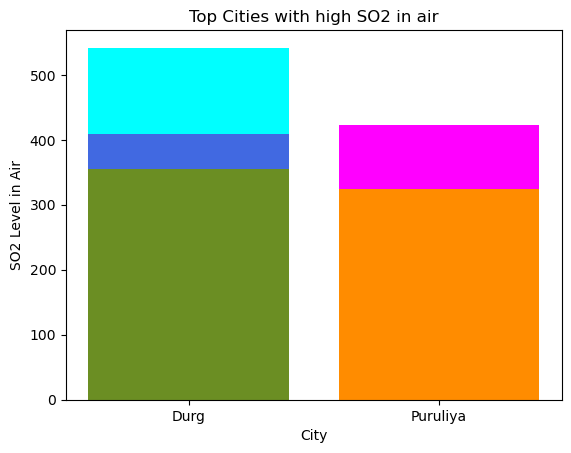

In [72]:
color_SO2_air =['cyan','fuchsia','royalblue','olivedrab','darkorange','steelblue']
plt.bar(location_high_SO2,high_SO2_air,color=color_SO2_air)
plt.xlabel('City')
plt.ylabel('SO2 Level in Air')
plt.title('Top Cities with high SO2 in air')

Text(0, 0.5, 'Frequency')

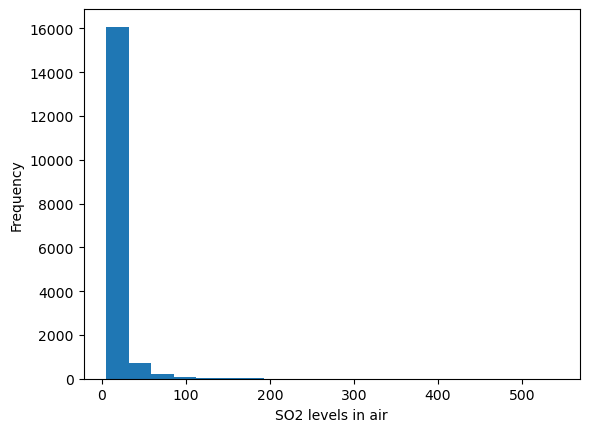

In [73]:
plt.hist(high_SO2_inair['air_quality_Sulphur_dioxide'],bins=20)
plt.xlabel('SO2 levels in air')
plt.ylabel('Frequency')

### Handling Categorical Variables

In [74]:
train_df['weather'].unique()

array(['Partly cloudy', 'Sunny', 'Cloudy', 'Mist', 'Patchy rain possible',
       'Overcast', 'Patchy light rain with thunder', 'Light rain shower',
       'Moderate or heavy rain shower', 'Clear', 'Light rain',
       'Torrential rain shower', 'Fog', 'Thundery outbreaks possible',
       'Patchy light drizzle', 'Moderate rain', 'Patchy light rain',
       'Moderate rain at times', 'Heavy rain', 'Heavy rain at times',
       'Light drizzle', 'Moderate or heavy rain with thunder',
       'Patchy snow possible', 'Moderate or heavy snow showers',
       'Light snow showers', 'Moderate or heavy snow with thunder',
       'Patchy light snow with thunder', 'Light sleet',
       'Light freezing rain', 'Patchy light snow', 'Patchy moderate snow',
       'Light snow', 'Moderate snow'], dtype=object)

In [75]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 64024 entries, 0 to 64023
Data columns (total 23 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   location_name                 64024 non-null  object 
 1   region                        64024 non-null  object 
 2   latitude                      64024 non-null  float64
 3   longitude                     64024 non-null  float64
 4   temperature_celsius           64024 non-null  float64
 5   wind_kph                      64024 non-null  float64
 6   wind_degree                   64024 non-null  int64  
 7   pressure_mb                   64024 non-null  float64
 8   precip_mm                     64024 non-null  float64
 9   humidity                      64024 non-null  int64  
 10  cloud                         64024 non-null  int64  
 11  feels_like_celsius            64024 non-null  float64
 12  visibility_km                 64024 non-null  float64
 13  u

In [76]:
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler

In [77]:
train_df['Location'] = train_df['location_name'] + ',' + train_df['region']

In [78]:
train_df.head()

,location_name,region,latitude,longitude,temperature_celsius,wind_kph,wind_degree,pressure_mb,precip_mm,humidity,...,gust_kph,air_quality_Carbon_Monoxide,air_quality_Ozone,air_quality_Nitrogen_dioxide,air_quality_Sulphur_dioxide,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,weather,Location
0,Ashoknagar,Madhya Pradesh,24.57,77.72,27.5,20.5,281,1008.0,0.0,67,...,23.8,243.7,45.8,1.7,3.1,12.6,18.5,1,Partly cloudy,"Ashoknagar,Madhya Pradesh"
1,Raisen,Madhya Pradesh,23.33,77.80,27.5,15.5,287,1008.0,0.0,70,...,18.0,240.3,38.3,2.1,2.6,10.7,14.2,1,Sunny,"Raisen,Madhya Pradesh"
2,Chhindwara,Madhya Pradesh,22.07,78.93,26.3,18.4,317,1009.0,0.0,70,...,21.2,220.3,57.2,0.6,1.7,16.8,20.7,2,Partly cloudy,"Chhindwara,Madhya Pradesh"
3,Betul,Madhya Pradesh,21.86,77.93,25.6,16.9,297,1009.0,0.0,76,...,20.9,200.3,25.0,1.2,1.1,4.9,6.6,1,Cloudy,"Betul,Madhya Pradesh"
4,Hoshangabad,Madhya Pradesh,22.75,77.72,27.2,16.2,274,1009.0,0.0,74,...,18.7,257.0,30.8,2.2,1.8,11.4,14.8,1,Cloudy,"Hoshangabad,Madhya Pradesh"


In [79]:
train_df


,location_name,region,latitude,longitude,temperature_celsius,wind_kph,wind_degree,pressure_mb,precip_mm,humidity,...,gust_kph,air_quality_Carbon_Monoxide,air_quality_Ozone,air_quality_Nitrogen_dioxide,air_quality_Sulphur_dioxide,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,weather,Location
0,Ashoknagar,Madhya Pradesh,24.57,77.72,27.5,20.5,281,1008.0,0.00,67,...,23.8,243.7,45.8,1.7,3.1,12.6,18.5,1,Partly cloudy,"Ashoknagar,Madhya Pradesh"
1,Raisen,Madhya Pradesh,23.33,77.80,27.5,15.5,287,1008.0,0.00,70,...,18.0,240.3,38.3,2.1,2.6,10.7,14.2,1,Sunny,"Raisen,Madhya Pradesh"
2,Chhindwara,Madhya Pradesh,22.07,78.93,26.3,18.4,317,1009.0,0.00,70,...,21.2,220.3,57.2,0.6,1.7,16.8,20.7,2,Partly cloudy,"Chhindwara,Madhya Pradesh"
3,Betul,Madhya Pradesh,21.86,77.93,25.6,16.9,297,1009.0,0.00,76,...,20.9,200.3,25.0,1.2,1.1,4.9,6.6,1,Cloudy,"Betul,Madhya Pradesh"
4,Hoshangabad,Madhya Pradesh,22.75,77.72,27.2,16.2,274,1009.0,0.00,74,...,18.7,257.0,30.8,2.2,1.8,11.4,14.8,1,Cloudy,"Hoshangabad,Madhya Pradesh"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64019,Niwari,Uttar Pradesh,28.88,77.53,12.0,6.8,260,1020.0,0.00,100,...,16.6,1562.1,34.0,29.1,6.9,348.0,388.9,6,Fog,"Niwari,Uttar Pradesh"
64020,Saitual,Mizoram,23.97,92.58,10.2,4.3,116,1018.0,0.00,90,...,9.1,427.3,5.0,7.0,1.2,23.5,27.3,2,Partly cloudy,"Saitual,Mizoram"
64021,Ranipet,Tamil Nadu,12.93,79.33,20.9,10.4,322,1015.0,0.00,86,...,17.3,427.3,58.7,4.9,1.0,72.0,85.1,4,Partly cloudy,"Ranipet,Tamil Nadu"
64022,Tenkasi,Tamil Nadu,8.97,77.30,20.3,11.2,92,1013.0,0.01,88,...,21.9,400.5,73.0,4.1,9.9,27.6,32.4,2,Patchy rain possible,"Tenkasi,Tamil Nadu"


In [80]:
train_df.drop('location_name',axis=1,inplace=True)

In [81]:
train_df.head()

,region,latitude,longitude,temperature_celsius,wind_kph,wind_degree,pressure_mb,precip_mm,humidity,cloud,...,gust_kph,air_quality_Carbon_Monoxide,air_quality_Ozone,air_quality_Nitrogen_dioxide,air_quality_Sulphur_dioxide,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,weather,Location
0,Madhya Pradesh,24.57,77.72,27.5,20.5,281,1008.0,0.0,67,26,...,23.8,243.7,45.8,1.7,3.1,12.6,18.5,1,Partly cloudy,"Ashoknagar,Madhya Pradesh"
1,Madhya Pradesh,23.33,77.80,27.5,15.5,287,1008.0,0.0,70,19,...,18.0,240.3,38.3,2.1,2.6,10.7,14.2,1,Sunny,"Raisen,Madhya Pradesh"
2,Madhya Pradesh,22.07,78.93,26.3,18.4,317,1009.0,0.0,70,51,...,21.2,220.3,57.2,0.6,1.7,16.8,20.7,2,Partly cloudy,"Chhindwara,Madhya Pradesh"
3,Madhya Pradesh,21.86,77.93,25.6,16.9,297,1009.0,0.0,76,65,...,20.9,200.3,25.0,1.2,1.1,4.9,6.6,1,Cloudy,"Betul,Madhya Pradesh"
4,Madhya Pradesh,22.75,77.72,27.2,16.2,274,1009.0,0.0,74,82,...,18.7,257.0,30.8,2.2,1.8,11.4,14.8,1,Cloudy,"Hoshangabad,Madhya Pradesh"


In [82]:
df_encoded = pd.get_dummies(train_df, columns=['Location','region'])

In [83]:
df_encoded

,latitude,longitude,temperature_celsius,wind_kph,wind_degree,pressure_mb,precip_mm,humidity,cloud,feels_like_celsius,...,region_Nagaland,region_Orissa,region_Puducherry,region_Punjab,region_Rajasthan,region_Tamil Nadu,region_Tripura,region_Uttar Pradesh,region_Uttarakhand,region_West Bengal
0,24.57,77.72,27.5,20.5,281,1008.0,0.00,67,26,29.7,...,0,0,0,0,0,0,0,0,0,0
1,23.33,77.80,27.5,15.5,287,1008.0,0.00,70,19,30.0,...,0,0,0,0,0,0,0,0,0,0
2,22.07,78.93,26.3,18.4,317,1009.0,0.00,70,51,28.2,...,0,0,0,0,0,0,0,0,0,0
3,21.86,77.93,25.6,16.9,297,1009.0,0.00,76,65,27.6,...,0,0,0,0,0,0,0,0,0,0
4,22.75,77.72,27.2,16.2,274,1009.0,0.00,74,82,29.9,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64019,28.88,77.53,12.0,6.8,260,1020.0,0.00,100,0,11.4,...,0,0,0,0,0,0,0,1,0,0
64020,23.97,92.58,10.2,4.3,116,1018.0,0.00,90,31,10.2,...,0,0,0,0,0,0,0,0,0,0
64021,12.93,79.33,20.9,10.4,322,1015.0,0.00,86,54,20.9,...,0,0,0,0,0,1,0,0,0,0
64022,8.97,77.30,20.3,11.2,92,1013.0,0.01,88,95,20.3,...,0,0,0,0,0,1,0,0,0,0


In [84]:
from sklearn.preprocessing import LabelEncoder

In [85]:
columns_to_label_encode = ["Destination", "Airline", "Source", "Additional_Info"]
label_encoders = {}

for column in columns_to_label_encode:
    label_encoder = LabelEncoder()
    test_df[column] = label_encoder.fit_transform(test_df[column])
    
    # Save the classes to a file
    classes_filename_test = f'le_{column}_classes.npy'
    np.save(classes_filename_test, label_encoder.classes_)
    
    # Store the LabelEncoder and its classes filename in the dictionary
    label_encoders[column] = {"encoder": label_encoder, "classes_filename": classes_filename_test}


In [86]:
train_df

,region,latitude,longitude,temperature_celsius,wind_kph,wind_degree,pressure_mb,precip_mm,humidity,cloud,...,gust_kph,air_quality_Carbon_Monoxide,air_quality_Ozone,air_quality_Nitrogen_dioxide,air_quality_Sulphur_dioxide,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,weather,Location
0,19,24.57,77.72,27.5,20.5,281,1008.0,0.00,67,26,...,23.8,243.7,45.8,1.7,3.1,12.6,18.5,1,Partly cloudy,27
1,19,23.33,77.80,27.5,15.5,287,1008.0,0.00,70,19,...,18.0,240.3,38.3,2.1,2.6,10.7,14.2,1,Sunny,411
2,19,22.07,78.93,26.3,18.4,317,1009.0,0.00,70,51,...,21.2,220.3,57.2,0.6,1.7,16.8,20.7,2,Partly cloudy,106
3,19,21.86,77.93,25.6,16.9,297,1009.0,0.00,76,65,...,20.9,200.3,25.0,1.2,1.1,4.9,6.6,1,Cloudy,65
4,19,22.75,77.72,27.2,16.2,274,1009.0,0.00,74,82,...,18.7,257.0,30.8,2.2,1.8,11.4,14.8,1,Cloudy,206
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64019,30,28.88,77.53,12.0,6.8,260,1020.0,0.00,100,0,...,16.6,1562.1,34.0,29.1,6.9,348.0,388.9,6,Fog,374
64020,22,23.97,92.58,10.2,4.3,116,1018.0,0.00,90,31,...,9.1,427.3,5.0,7.0,1.2,23.5,27.3,2,Partly cloudy,434
64021,28,12.93,79.33,20.9,10.4,322,1015.0,0.00,86,54,...,17.3,427.3,58.7,4.9,1.0,72.0,85.1,4,Partly cloudy,420
64022,28,8.97,77.30,20.3,11.2,92,1013.0,0.01,88,95,...,21.9,400.5,73.0,4.1,9.9,27.6,32.4,2,Patchy rain possible,496


### Model Training

In [87]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 64024 entries, 0 to 64023
Data columns (total 23 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   region                        64024 non-null  int32  
 1   latitude                      64024 non-null  float64
 2   longitude                     64024 non-null  float64
 3   temperature_celsius           64024 non-null  float64
 4   wind_kph                      64024 non-null  float64
 5   wind_degree                   64024 non-null  int64  
 6   pressure_mb                   64024 non-null  float64
 7   precip_mm                     64024 non-null  float64
 8   humidity                      64024 non-null  int64  
 9   cloud                         64024 non-null  int64  
 10  feels_like_celsius            64024 non-null  float64
 11  visibility_km                 64024 non-null  float64
 12  uv_index                      64024 non-null  float64
 13  g

In [88]:
X=train_df.drop('weather',axis=1)

In [89]:
X

,region,latitude,longitude,temperature_celsius,wind_kph,wind_degree,pressure_mb,precip_mm,humidity,cloud,...,uv_index,gust_kph,air_quality_Carbon_Monoxide,air_quality_Ozone,air_quality_Nitrogen_dioxide,air_quality_Sulphur_dioxide,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,Location
0,19,24.57,77.72,27.5,20.5,281,1008.0,0.00,67,26,...,7.0,23.8,243.7,45.8,1.7,3.1,12.6,18.5,1,27
1,19,23.33,77.80,27.5,15.5,287,1008.0,0.00,70,19,...,7.0,18.0,240.3,38.3,2.1,2.6,10.7,14.2,1,411
2,19,22.07,78.93,26.3,18.4,317,1009.0,0.00,70,51,...,7.0,21.2,220.3,57.2,0.6,1.7,16.8,20.7,2,106
3,19,21.86,77.93,25.6,16.9,297,1009.0,0.00,76,65,...,6.0,20.9,200.3,25.0,1.2,1.1,4.9,6.6,1,65
4,19,22.75,77.72,27.2,16.2,274,1009.0,0.00,74,82,...,6.0,18.7,257.0,30.8,2.2,1.8,11.4,14.8,1,206
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64019,30,28.88,77.53,12.0,6.8,260,1020.0,0.00,100,0,...,1.0,16.6,1562.1,34.0,29.1,6.9,348.0,388.9,6,374
64020,22,23.97,92.58,10.2,4.3,116,1018.0,0.00,90,31,...,1.0,9.1,427.3,5.0,7.0,1.2,23.5,27.3,2,434
64021,28,12.93,79.33,20.9,10.4,322,1015.0,0.00,86,54,...,1.0,17.3,427.3,58.7,4.9,1.0,72.0,85.1,4,420
64022,28,8.97,77.30,20.3,11.2,92,1013.0,0.01,88,95,...,1.0,21.9,400.5,73.0,4.1,9.9,27.6,32.4,2,496


In [90]:
X.shape

(64024, 22)

In [91]:
y=train_df['weather']

In [92]:
y.shape

(64024,)

In [93]:
# Important feature using ExtraTreesClassifier
from sklearn.ensemble import ExtraTreesClassifier
selection = ExtraTreesClassifier()
selection.fit(X, y)

ExtraTreesClassifier()

In [94]:
print(selection.feature_importances_)

[0.0121549  0.0247502  0.01859214 0.02073666 0.01690004 0.01641691
 0.02463592 0.05797803 0.07078689 0.31275333 0.02131581 0.25329509
 0.02246748 0.01471174 0.01352626 0.01366017 0.0127809  0.01209913
 0.01581258 0.01635732 0.01963281 0.00863572]


<AxesSubplot:>

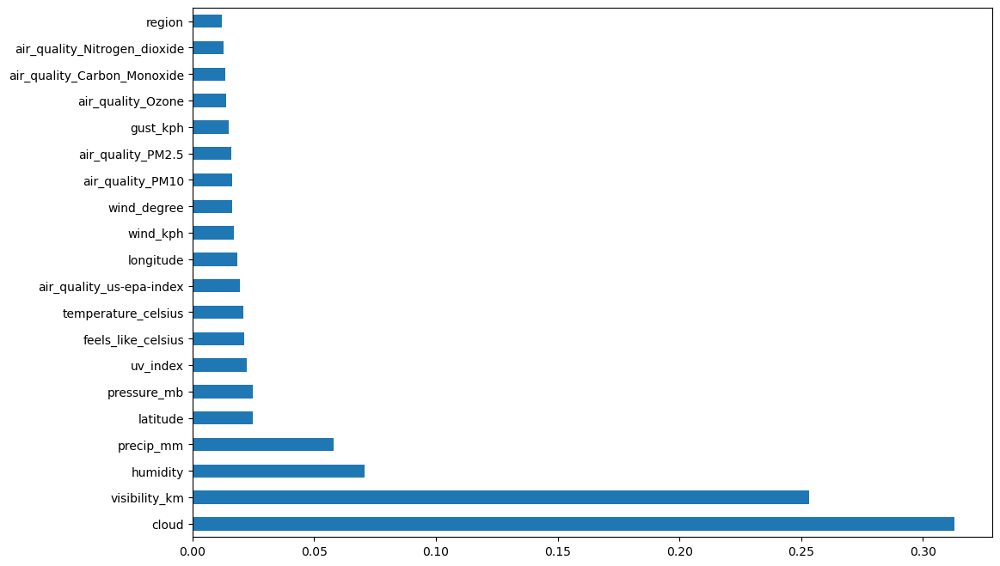

In [95]:
#plot graph of feature importances for better visualization

plt.figure(figsize = (12,8))
feat_importances = pd.Series(selection.feature_importances_, index=X.columns)
feat_importances.nlargest(20).plot(kind='barh')

In [96]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42)

In [97]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score,classification_report,confusion_matrix,precision_score,recall_score,f1_score

In [98]:
models= {
    'Decision Tree' : DecisionTreeClassifier(),
    'Random Forest' : RandomForestClassifier(),
    'Naive bayes'   : GaussianNB(),
    'Gradient Boosting' : GradientBoostingClassifier(),
    'KNN'           : KNeighborsClassifier()
}

for i in range(len(list(models))):
    model= list(models.values())[i]
    model.fit(X_train,y_train)
    
    #Making predictions
    y_train_prediction = model.predict(X_train)
    y_test_prediction = model.predict(X_test)
    
    ## evaluating performance metrics for training set
    model_train_accuracy = accuracy_score(y_train,y_train_prediction)
    model_train_precision = precision_score(y_train,y_train_prediction,average='weighted')
    model_train_recall = recall_score(y_train,y_train_prediction,average='weighted')
    model_train_f1score = f1_score(y_train,y_train_prediction,average='weighted')
    
    
    ## evaluating performance metrics for test set
    model_test_accuracy = accuracy_score(y_test,y_test_prediction)
    model_test_precision = precision_score(y_test,y_test_prediction,average='weighted')
    model_test_recall = recall_score(y_test,y_test_prediction,average='weighted')
    model_test_f1score = f1_score(y_test,y_test_prediction,average='weighted')
    
    print(list(models.keys())[i])
    
    print('Model performance in Training set is:')
    print('- Accuracy :{:.4f}'.format(model_train_accuracy))
    print('- Precision :{:.4f}'.format(model_train_precision))
    print('- Recall :{:.4f}'.format(model_train_recall))
    print('- F1 Score :{:.4f}'.format(model_train_f1score))
    
    
    print("-------------------------------------------------")
    
    
    print("Model Performance in test set is:")
    print('- Accuracy :{:.4f}'.format(model_test_accuracy))
    print('- Precision :{:.4f}'.format(model_test_precision))
    print('- Recall :{:.4f}'.format(model_test_recall))
    print('- F1 Score :{:.4f}'.format(model_test_f1score))
    
    print('='*55)
    print('\n')  

C:\Users\SAIKRISHNA\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Decision Tree
Model performance in Training set is:
- Accuracy :1.0000
- Precision :1.0000
- Recall :1.0000
- F1 Score :1.0000
-------------------------------------------------
Model Performance in test set is:
- Accuracy :0.9804
- Precision :0.9805
- Recall :0.9804
- F1 Score :0.9804




C:\Users\SAIKRISHNA\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Random Forest
Model performance in Training set is:
- Accuracy :1.0000
- Precision :1.0000
- Recall :1.0000
- F1 Score :1.0000
-------------------------------------------------
Model Performance in test set is:
- Accuracy :0.9823
- Precision :0.9818
- Recall :0.9823
- F1 Score :0.9804




C:\Users\SAIKRISHNA\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

C:\Users\SAIKRISHNA\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.



Naive bayes
Model performance in Training set is:
- Accuracy :0.7430
- Precision :0.8583
- Recall :0.7430
- F1 Score :0.7506
-------------------------------------------------
Model Performance in test set is:
- Accuracy :0.7442
- Precision :0.8575
- Recall :0.7442
- F1 Score :0.7543




C:\Users\SAIKRISHNA\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

C:\Users\SAIKRISHNA\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

C:\Users\SAIKRISHNA\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.



Gradient Boosting
Model performance in Training set is:
- Accuracy :0.9744
- Precision :0.9762
- Recall :0.9744
- F1 Score :0.9735
-------------------------------------------------
Model Performance in test set is:
- Accuracy :0.9666
- Precision :0.9667
- Recall :0.9666
- F1 Score :0.9645




C:\Users\SAIKRISHNA\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



KNN
Model performance in Training set is:
- Accuracy :0.7732
- Precision :0.7571
- Recall :0.7732
- F1 Score :0.7535
-------------------------------------------------
Model Performance in test set is:
- Accuracy :0.6911
- Precision :0.6506
- Recall :0.6911
- F1 Score :0.6619




C:\Users\SAIKRISHNA\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [99]:
#Hyperparameter tuning

rf_params={'n_estimators': [100,200,300,500,1000],
           'max_depth' :[5,8,10,15,None],
           'min_samples_split' : [2,4,6,8,10],
           'max_features' : [5,7,"auto",8]}

In [100]:
rf_params

{'n_estimators': [100, 200, 300, 500, 1000],
 'max_depth': [5, 8, 10, 15, None],
 'min_samples_split': [2, 4, 6, 8, 10],
 'max_features': [5, 7, 'auto', 8]}

In [101]:
randomcv_models =[
    ("Random Forest", RandomForestClassifier(),rf_params),
]

In [102]:
randomcv_models

[('Random Forest',
  RandomForestClassifier(),
  {'n_estimators': [100, 200, 300, 500, 1000],
   'max_depth': [5, 8, 10, 15, None],
   'min_samples_split': [2, 4, 6, 8, 10],
   'max_features': [5, 7, 'auto', 8]})]

In [103]:
from sklearn.model_selection import RandomizedSearchCV

In [104]:
# model_param={}
#using it for one time and commenting it since it took hours to execute
# for name, model, params in randomcv_models:
#     random = RandomizedSearchCV(estimator=model,
#                                 param_distributions=params,
#                                 n_iter=100,
#                                 verbose=2,
#                                 n_jobs=-1)
    
#     random.fit(X_train,y_train)
#     model_param[name]= random.best_params_
    
# for model_name in model_param:
#     print(f" --------------Best Params {model_name}-----------")
#     print(model_param[model_name])

In [105]:
models= {
    'Random Forest' : RandomForestClassifier(n_estimators= 500, min_samples_split= 2, max_features=8, max_depth=None)
}

for i in range(len(list(models))):
    model= list(models.values())[i]
    model.fit(X_train,y_train)
    
    #Making predictions
    y_train_prediction = model.predict(X_train)
    y_test_prediction = model.predict(X_test)
    
    ## evaluating performance metrics for training set
    model_train_accuracy = accuracy_score(y_train,y_train_prediction)
    model_train_precision = precision_score(y_train,y_train_prediction,average='weighted')
    model_train_recall = recall_score(y_train,y_train_prediction,average='weighted')
    model_train_f1score = f1_score(y_train,y_train_prediction,average='weighted')
    
    
    ## evaluating performance metrics for test set
    model_test_accuracy = accuracy_score(y_test,y_test_prediction)
    model_test_precision = precision_score(y_test,y_test_prediction,average='weighted')
    model_test_recall = recall_score(y_test,y_test_prediction,average='weighted')
    model_test_f1score = f1_score(y_test,y_test_prediction,average='weighted')
    
    print(list(models.keys())[i])
    
    print('Model performance in Training set is:')
    print('- Accuracy :{:.4f}'.format(model_train_accuracy))
    print('- Precision :{:.4f}'.format(model_train_precision))
    print('- Recall :{:.4f}'.format(model_train_recall))
    print('- F1 Score :{:.4f}'.format(model_train_f1score))
    
    
    print("-------------------------------------------------")
    
    
    print("Model Performance in test set is:")
    print('- Accuracy :{:.4f}'.format(model_test_accuracy))
    print('- Precision :{:.4f}'.format(model_test_precision))
    print('- Recall :{:.4f}'.format(model_test_recall))
    print('- F1 Score :{:.4f}'.format(model_test_f1score))
    
    print('='*55)
    print('\n')  

Random Forest
Model performance in Training set is:
- Accuracy :1.0000
- Precision :1.0000
- Recall :1.0000
- F1 Score :1.0000
-------------------------------------------------
Model Performance in test set is:
- Accuracy :0.9849
- Precision :0.9842
- Recall :0.9849
- F1 Score :0.9837




C:\Users\SAIKRISHNA\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

